In [1]:
import json
import pandas as pd
import numpy as np

import os
import datetime
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.applications.imagenet_utils import decode_predictions
import matplotlib.pyplot as plt
from PIL import Image

from sklearn.model_selection import train_test_split
from keras.utils import to_categorical

import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Activation, InputLayer, Conv2D, MaxPooling2D
from keras.layers.normalization import BatchNormalization
from keras.layers.advanced_activations import LeakyReLU

from keras.initializers import glorot_normal

import math
from keras.datasets import cifar100
from scipy.cluster.vq import whiten

import glob
import os

from keras.applications import InceptionV3, Xception, InceptionResNetV2
from keras import Model

%matplotlib inline

/Users/jonathanjanke/anaconda3/envs/py36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.
/Users/jonathanjanke/anaconda3/envs/py36/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


<font color="red">CUt out images instead of spreading them </font>

In [4]:
def load_image(filename, img_rows=100, img_cols=100, plot=True):
    try:
        # load an image in PIL format
        original = load_img(filename, target_size=(img_rows, img_cols))

        # convert the PIL image to a numpy array
        # IN PIL - image is in (width, height, channel)
        # In Numpy - image is in (height, width, channel)
        numpy_image = img_to_array(original)

        # Convert the image / images into batch format
        # expand_dims will add an extra dimension to the data at a particular axis
        # We want the input matrix to the network to be of the form (batchsize, height, width, channels)
        # Thus we add the extra dimension to the axis 0.
        image_batch = np.expand_dims(numpy_image, axis=0)
        if plot: plt.imshow(np.uint8(image_batch[0]))
        return image_batch
    except IOError:
        # image_list.remove(filename)
        print("removed")
        return np.array([])

In [5]:
def fetch_data (file_path, img_rows=100, img_cols=100, cutoff=-1):
    # 2. Auto-iterate using the query syntax
    #    https://developers.google.com/drive/v2/web/search-parameters
    
    # file_list = glob.glob("./data/input/" + file_path + "/*.JPEG")
    file_list = glob.glob(file_path + "/*.JPEG")
  
    final_images = []
    batches = []
    for f in file_list[0:cutoff]:
        curr_image = load_image(f, img_rows, img_cols)
        if curr_image.size != 0:
            final_images.append(f)
            batches.append(curr_image)
    batches = [b[0] for b in batches]
    return final_images, np.array(batches)

In [6]:
def fetch_data_from_classes (file_path, img_rows=100, img_cols=100, classes = list(range(1,1001)), label_file = "351_Data/ILSVRC2012_Validation/labels/ILSVRC2012_devkit_t12/data/ILSVRC2012_validation_ground_truth.txt"):
    # label_file = "351_Data\ILSVRC2012_Validation\labels\ILSVRC2012_devkit_t12\data\ILSVRC2012_validation_ground_truth.txt"
    # classes = list(range(1,101))

    labels = np.array(pd.read_csv(label_file, header=None, names=["Class"], engine='python'))
    # inclass_labels = [el for ind,el in enumerate(labels) if el in classes]
    indices = [ind for ind,el in enumerate(labels) if el in classes]
    inclass_labels = labels[np.sort(indices)]
    
    file_list = glob.glob(file_path + "/*.JPEG")
    file_list = np.sort([f for f in file_list if int(f.split("_")[-1].split(".JPEG")[0]) - 1 in indices])
    
    final_images = []
    batches = []
    for f in file_list:
        curr_image = load_image(f, img_rows, img_cols,True)
        if curr_image.size != 0:
            final_images.append(f)
            batches.append(curr_image)
    batches = [b[0] for b in batches]
    return final_images, np.array(batches),inclass_labels

# Neural network test

In [7]:
# WIP

def format_data_in_pieces(x_train, x_test, size=100):
    train = np.array([])
    test = np.array([])
    ind = 0
    while True:
        a,b = format_data(x_train[ind : ind + size], x_test[ind : ind + size])
        np.append(train, np.array(a))
        np.append(test, np.array(b))
        
        if ind + size>=max(len(x_train), len(x_test)):
            np.append(train, np.array(x_train[ind : ]))
            np.append(test, np.array(x_test[ind : ]))
            break
        ind = ind + size
        
    return train,test

In [8]:
def general_preprocessing(image):    
    return image/255.

In [9]:
def format_data(x_train, x_test, preprocessing_function = general_preprocessing):
    x_train = x_train.astype('float32')
    x_test = x_test.astype('float32')
    x_train = preprocessing_function(x_train)
    x_test = preprocessing_function(x_test)
    return x_train, x_test

Does Whitening work when it is done independently on x_train and x_test? (e.g., should the same whitening factor be used on x_test as on x_train)

In [10]:
def filter_for_classes(X, y, classes):
    mask = np.isin(y, classes)
    mask = mask.reshape(len(mask))
    return X[mask], y[mask]

In [11]:
def whiten_data(x_train, x_test):
    X = np.append(x_train, x_test, axis=0)
    X_white = whiten(X).reshape(X.shape)
    x_train_white = X_white[0:x_train.shape[0]]
    x_test_white = X_white[x_train.shape[0]:x_train.shape[0]+x_test.shape[0]]
    return x_train_white, x_test_white

In [12]:
def create_output_files (x_train, x_test, y_train, y_test, prefix, suffix = ""):
    for model_ind, model in enumerate(models):
        pred_train = model.predict(x_train)
        pred_test = model.predict(x_test)
        pred_train_with_target = np.array([np.array([preds, y_train[i]]) for i,preds in enumerate(pred_train)])
        pred_test_with_target = np.array([np.array([preds, y_test[i]]) for i,preds in enumerate(pred_test)])
        path = input_path + "Intermediate/" + prefix + "/" + model_names[model_ind]
        if not os.path.exists(path):
            os.makedirs(path)
        save_data(path + "/train" + suffix, pred_train_with_target)
        save_data(pred_test_with_target)
        

In [13]:
def save_data (path,data,suffix = 0):
    try:
        np.save(path + "_" + str(suffix), data)
        return suffix
    except:
        data0,data1 = split_data(data)
        suffix = save_data(path,data0,suffix)
        return save_data(path,data1,suffix + 1)

In [14]:
def split_data (data):
    return data[:int(data.shape[0]/2)], data[int(data.shape[0]/2):]
    pred_train_with_target0 = pred_train_with_target[:2000]
    pred_train_with_target1 = pred_train_with_target[2000:]

In [15]:
def dev_pipeline(class_start, class_end, prefix):
    final_images, batches,curr_labels = fetch_data_from_classes(input_path + "images", img_rows, img_cols, classes = list(range(class_start,class_end)))
    x_train, x_test, y_train, y_test = train_test_split(batches, curr_labels, test_size=0.25)
    x_train, x_test = format_data(x_train, x_test)
    classes_to_retain = range(class_start,class_end)
    num_classes = len(classes_to_retain)
    x_train, y_train = filter_for_classes(x_train, y_train, classes_to_retain)
    x_test, y_test = filter_for_classes(x_test,y_test,classes_to_retain)
    x_train, x_test = whiten_data(x_train,x_test)
    y_train_categorical = to_categorical(y_train)
    y_test_categorical = to_categorical(y_test)
    suffix = "_{}-{}".format(class_start, class_end)
    create_output_files(x_train, x_test, y_train, y_test, prefix, suffix)

In [16]:
def run_all(prefix, class_chunk_size=10, label_file = "351_Data\ILSVRC2012_Validation\labels\ILSVRC2012_devkit_t12\data\ILSVRC2012_validation_ground_truth.txt"):
    labels = np.array(pd.read_csv(label_file, header=None, names=["Class"]))
    num_classes = len(np.unique(labels))
    start_ind = min (np.unique(labels))
    # path = input_path + "Intermediate\\" + prefix + "\\" + model_names[model_ind]
    # if not os.path.exists(path):
    #    os.makedirs(path)

    while True:
        dev_pipeline(start_ind, start_ind + class_chunk_size, prefix)
        if start_ind+ class_chunk_size>max(np.unique(labels)):
            dev_pipeline(start_ind, max(np.unique(labels)) + 1, prefix)
            break
        start_ind = start_ind + class_chunk_size    

In [17]:
def show_image_classes(images, classes, prefix, suffix=""):
    for cl in np.unique(y_train):
        for ind,el in enumerate(y_train):
            if el == cl:
                class_pos = ind
                break
        plt.figure()
        plt.imshow(np.uint8(x_train[class_pos]))
        path = "353_Sample_Images/" + prefix + "/"
        if not os.path.exists(path):
            os.makedirs(path)
        plt.savefig(path + input_path.split("/")[1].split("_")[0] + "_" + str(cl) + "_sample_image_" + suffix)

In [18]:
def preprocess_input_incpv3(image):
    image /= 255.
    image -= 0.5
    image *= 2.
    return image

In [19]:
# incepresnet from https://github.com/fchollet/deep-learning-models/blob/master/inception_resnet_v2.py
# xception from https://github.com/fchollet/deep-learning-models/blob/master/xception.py
# inception v3 from https://github.com/fchollet/deep-learning-models/blob/master/inception_v3.py
def preprocess_input(x):
    """Preprocesses a numpy array encoding a batch of images.
    This function applies the "Inception" preprocessing which converts
    the RGB values from [0, 255] to [-1, 1]. Note that this preprocessing
    function is different from `imagenet_utils.preprocess_input()`.
    # Arguments
        x: a 4D numpy array consists of RGB values within [0, 255].
    # Returns
        Preprocessed array.
    """
    x /= 255.
    x -= 0.5
    x *= 2.
    return x

## Model Definition

I will start by "randomly" creating models.

everything from class_start till class_end is included in the data (excluding class_end)

In [20]:
class_start = 1
class_end = 101

In [21]:
input_path = "351_Data/ILSVRC2012_Validation/"

In [22]:
img_rows, img_cols = 299, 299

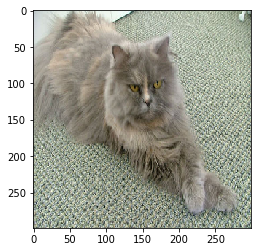

In [23]:
final_images, batches,curr_labels = fetch_data_from_classes(input_path + "images", img_rows, img_cols, classes = list(range(class_start,class_end)))

Check if the output is correct

In [24]:
class_n_pos = [ind for ind,el in enumerate(curr_labels) if el == 30]

/Users/jonathanjanke/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


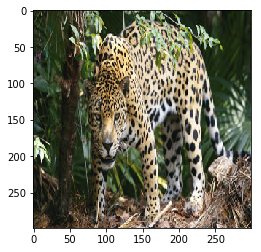

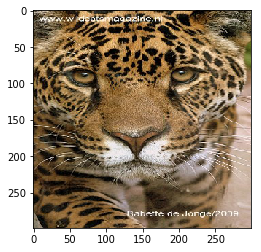

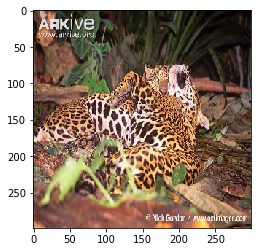

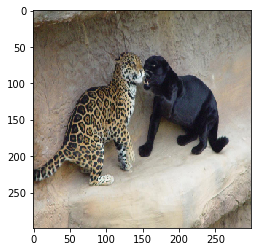

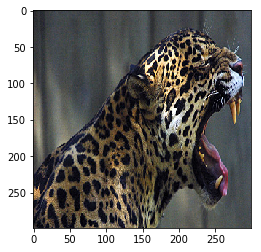

...

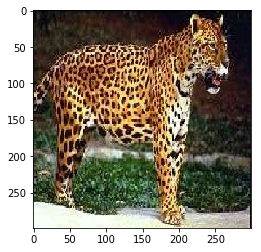

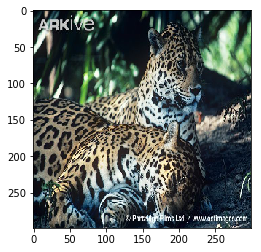

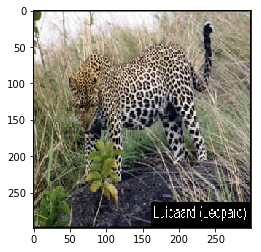

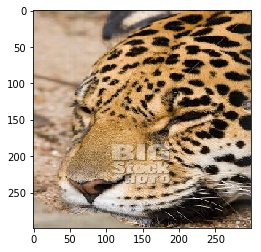

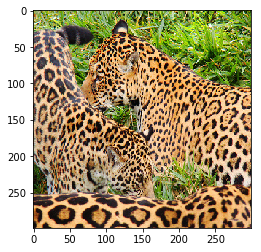

In [26]:
for img in class_n_pos:
    plt.figure()
    plt.imshow(np.uint8(batches[img]))

In [25]:
models = []
model_names = []
input_shape = batches[0].shape

In [26]:
incpv3_model = InceptionV3(include_top=False, input_shape=input_shape, weights='imagenet')
models.append(incpv3_model)
model_names.append("InceptionV3")

In [27]:
xcep_model = Xception(include_top=False, input_shape=input_shape, weights='imagenet')
models.append(xcep_model)
model_names.append("Xception")

In [28]:
incepresnet_model = InceptionResNetV2(include_top=False, input_shape=input_shape, weights='imagenet')
models.append(incepresnet_model)
model_names.append("Inception ResNet")

In [29]:
for model in models:
    print(model.count_params())

21802784
20861480
54336736


In [31]:
for ind, model in enumerate(models):
    output = model.layers[-1].output
    output_ = Flatten()(output)
    # output = Dense(output_dim=1000, activation='relu')(output) # your newlayer Dense(...)
    models[ind] = Model(model.input, output_)

In [32]:
now = datetime.datetime.now()
prefix = now.strftime("%Y%m%d_%H%M")

In [33]:
x_train, x_test, y_train, y_test = train_test_split(batches, curr_labels, test_size=0.25)

/Users/jonathanjanke/anaconda3/envs/py36/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


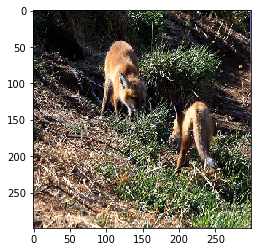

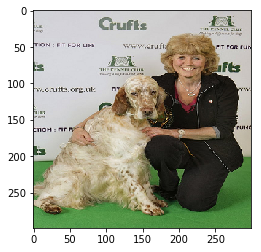

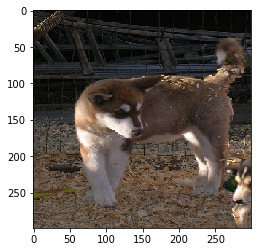

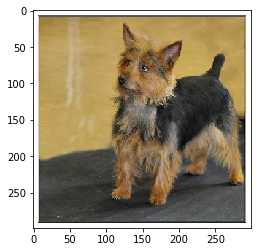

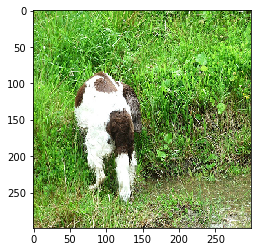

...

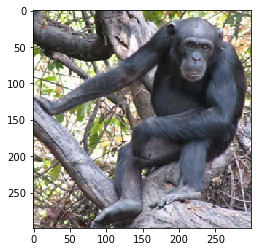

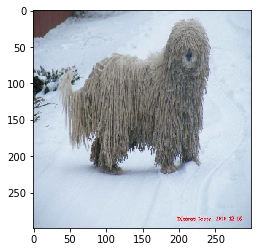

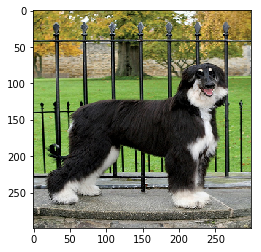

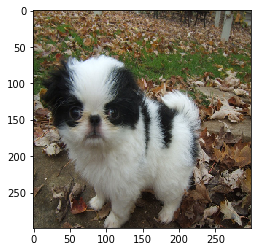

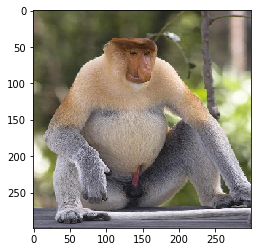

In [34]:
show_image_classes(x_train,y_train,prefix,"raw")

In [35]:
x_train, x_test = format_data(x_train, x_test,preprocess_input)

In [36]:
classes_to_retain = range(class_start,class_end)
num_classes = len(classes_to_retain)

In [37]:
y_train_categorical = to_categorical(y_train)
y_test_categorical = to_categorical(y_test)
# suffix = "_{}-{}".format(class_start, class_end)

In [41]:
suffix = ""

for model_ind, model in enumerate(models):
    path = input_path + "Intermediate/" + prefix + "/" + model_names[model_ind]
    if not os.path.exists(path):
        os.makedirs(path)
    pred_train = model.predict(x_train)
    pred_test = model.predict(x_test)
    pred_train_with_target = np.array([np.array([preds, y_train[i]]) for i,preds in enumerate(pred_train)])
    pred_test_with_target = np.array([np.array([preds, y_test[i]]) for i,preds in enumerate(pred_test)])
    save_data(path + "/train" + suffix,pred_train_with_target)
    save_data(path + "/test" + suffix,pred_test_with_target)

In [43]:
pred_train_with_target.shape

(3750, 2)

1

In [90]:
np.save(path + "/test" + suffix, pred_test_with_target)

In [99]:
np.save(path + "/train_0" + suffix, pred_train_with_target_0)

In [100]:
np.save(path + "/train_1" + suffix, pred_train_with_target_1)

In [83]:
# commented out while debugging
# create_output_files(x_train, x_test, y_train, y_test, prefix, suffix)